# Score-Based Generative Modeling Through Stochastic Differential Equations
Gaëtan Ecrepont, Samson Gourevitch, Logan Renaud

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import functools
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from torchvision.utils import make_grid
from IPython.display import HTML
from torch.optim import Adam
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torchvision.datasets import MNIST
from tqdm import notebook
from scipy import integrate


from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Model

In [ ]:
class TimeEmbedding(nn.Module):
  """Gaussian random features for encoding time."""
  def __init__(self, embed_dim, scale=30.0):
    """Initialize Gaussian random features.
    Args:
      embed_dim: the dimensionality of the output embedding.
      scale: the scale of the Gaussian random features.
    """
    super().__init__()
    self.W = nn.Parameter(torch.randn(embed_dim//2)*scale, requires_grad=False)
  def forward(self, x):
    theta = x[:,None]*self.W[None,:] * 2 * np.pi
    return torch.cat([torch.sin(theta), torch.cos(theta)], dim=-1)


class Dense(nn.Module):
  """Fully connected layer + reshape outputs to feature maps (i.e. with width and height of 1 each)."""
  def __init__(self, input_dim, output_dim):
    super().__init__()
    self.dense = nn.Linear(input_dim, output_dim)
  def forward(self, x):
    return self.dense(x)[...,None,None] # same as [:,:,None,None]


class ScoreNet(nn.Module):
  "Time-conditional U-Net to estimate the score network."""
  def __init__(self, marginal_prob_std, channels=[32,64,128,256], embed_dim=256):
    """Initialize a time-dependent score-based network.
    Args:
      marginal_prob_std: A function that takes time t and gives the standard
        deviation of the perturbation kernel p_{0t}(x(t) | x(0)).
      channels: The number of channels for feature maps for each layer.
      embed_dim: The dimensionality of the Gaussian random feature embedding.
    """
    super().__init__()
    # embed time
    self.embed = nn.Sequential(TimeEmbedding(embed_dim=embed_dim), nn.Linear(embed_dim, embed_dim))
    # encoder
    self.conv1 = nn.Conv2d(in_channels=1, out_channels=channels[0], kernel_size=3, stride=1, bias=False)
    self.dense1 = Dense(embed_dim, channels[0])
    self.gnorm1 = nn.GroupNorm(num_groups=4, num_channels=channels[0])
    self.conv2 = nn.Conv2d(in_channels=channels[0], out_channels=channels[1], kernel_size=3, stride=2, bias=False)
    self.dense2 = Dense(embed_dim, channels[1])
    self.gnorm2 = nn.GroupNorm(num_groups=32, num_channels=channels[1])
    self.conv3 = nn.Conv2d(in_channels=channels[1], out_channels=channels[2], kernel_size=3, stride=2, bias=False)
    self.dense3 = Dense(embed_dim, channels[2])
    self.gnorm3 = nn.GroupNorm(num_groups=32, num_channels=channels[2])
    self.conv4 = nn.Conv2d(in_channels=channels[2], out_channels=channels[3], kernel_size=3, stride=2, bias=False)
    self.dense4 = Dense(embed_dim, channels[3])
    self.gnorm4 = nn.GroupNorm(num_groups=32, num_channels=channels[3])
    # decoder
    self.tconv4 = nn.ConvTranspose2d(in_channels=channels[3], out_channels=channels[2], kernel_size=3, stride=2, bias=False)
    self.dense5 = Dense(embed_dim, channels[2])
    self.tgnorm4 = nn.GroupNorm(num_groups=32, num_channels=channels[2])
    self.tconv3 = nn.ConvTranspose2d(in_channels=channels[2]*2, out_channels=channels[1], kernel_size=3, stride=2, bias=False, output_padding=1)
    self.dense6 = Dense(embed_dim, channels[1])
    self.tgnorm3 = nn.GroupNorm(num_groups=32, num_channels=channels[1])
    self.tconv2 = nn.ConvTranspose2d(in_channels=channels[1]*2, out_channels=channels[0], kernel_size=3, stride=2, bias=False, output_padding=1)
    self.dense7 = Dense(embed_dim, channels[0])
    self.tgnorm2 = nn.GroupNorm(num_groups=32, num_channels=channels[0])
    self.tconv1 = nn.ConvTranspose2d(in_channels=channels[0]*2, out_channels=1, kernel_size=3, stride=1)
    # activation
    self.activation = lambda x: x*torch.sigmoid(x) # swish activation function
    self.marginal_prob_std = marginal_prob_std

  def forward(self, x, t):
    # embed time
    embedding = self.activation(self.embed(t))
    # encoder
    h1 = self.activation( self.gnorm1( self.conv1(x)+self.dense1(embedding) ) )
    h2 = self.activation( self.gnorm2( self.conv2(h1)+self.dense2(embedding) ) )
    h3 = self.activation ( self.gnorm3( self.conv3(h2)+self.dense3(embedding) ) )
    h4 = self.activation ( self.gnorm4( self.conv4(h3)+self.dense4(embedding) ) )
    # decoder
    h5 = self.activation ( self.tgnorm4( self.tconv4(h4)+self.dense5(embedding) ) )
    h6 = self.activation ( self.tgnorm3( self.tconv3(torch.cat([h5,h3],dim=1))+self.dense6(embedding) ) )
    h7 = self.activation ( self.tgnorm2 ( self.tconv2(torch.cat([h6,h2],dim=1))+self.dense7(embedding) ) )
    h8 = self.tconv1(torch.cat([h7,h1], dim=1))
    # normalize output
    h = h8 / self.marginal_prob_std(t)[:,None,None,None]
    return h

## Training

In [ ]:
def diffusion_coef(t, sigma):
  """Compute the diffusion coefficient of the SDE we use, here dx = σ^t dW."""
  return sigma**t

def marginal_prob_std(t, sigma):
  """Compute the std of p_0t(x(t)|x(0)), in this case sqrt(int_0^t (σ^s)^2 ds)."""
  return torch.sqrt((sigma**(2*t)-1)/2/np.log(sigma))

def loss_fn(model, x, marginal_prob_std, eps=1e-5):
  """Loss function for score network.
  Epsilon is used to avoid numerical instability as t goes to 0.
  """
  random_t = torch.rand(x.shape[0], device=x.device) * (1.0 - eps) + eps
  z = torch.randn_like(x)
  std = marginal_prob_std(random_t)
  perturbed_x = x + z * std[:, None, None, None]
  score = model(perturbed_x, random_t)
  loss = torch.mean(torch.sum((score * std[:, None, None, None] + z)**2, dim=(1,2,3)))
  return loss

device = 'cuda'
sigma = 25.0 # diffusion coefficient

# define model
diffusion_coef_fn = functools.partial(diffusion_coef, sigma=sigma)
marginal_prob_std_fn = functools.partial(marginal_prob_std, sigma=sigma)
score_model = nn.DataParallel(ScoreNet(marginal_prob_std=marginal_prob_std_fn)).to(device) # enables parallelization

# define hyperparameters
n_epochs = 50
batch_size = 64
lr = 1e-4

# load and prepare data
transform = transforms.Compose([transforms.ToTensor(),transforms.Normalize((0.1307,), (0.3081,))]) # normalize the MNIST dataset
dataset = MNIST('.', train=True, transform=transform, download=True)
data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=8)

# define optimizer
optimizer = Adam(score_model.parameters(), lr=lr)

# # classic torch training loop
# score_model.train()
# tqdm_epoch = notebook.trange(n_epochs)
# for epoch in tqdm_epoch:
#   avg_loss = 0
#   num_items = 0
#   for x,y in data_loader:
#     x = x.to(device)
#     loss = loss_fn(score_model, x, marginal_prob_std_fn)
#     optimizer.zero_grad()
#     loss.backward()
#     optimizer.step()
#     avg_loss += loss.item() * x.shape[0]
#     num_items += x.shape[0]
#   tqdm_epoch.set_description(f'Average loss: {avg_loss/num_items:5f}')
#   torch.save(score_model.state_dict(), '/content/drive/MyDrive/Colab Notebooks/Diffusion/ckpt_100.pth')

# load weights we previously trained instead
ckpt = torch.load('/content/drive/MyDrive/Colab Notebooks/Diffusion/ckpt2.pth', weights_only=True)
score_model.load_state_dict(ckpt)

<ipython-input-6-60a7fa204075>:43: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('/content/drive/MyDrive/Colab Notebooks/Diffusion/ckpt2.pth')


  0%|          | 0/50 [00:00<?, ?it/s]

### Visualization utils

In [ ]:
def plot_samples(samples):
  """Plot samples from the diffusion process."""
  batch_size = samples.shape[0]
  fig, ax = plt.subplots(figsize=(5, 5))
  ax.axis('off')
  ax.imshow(make_grid(samples, nrow=int(batch_size**0.5), normalize=True, value_range=(0, 1)).permute(1,2,0).cpu().numpy())
  plt.show()


def generate_denoising_animation(samples, interval=5, step_size=1):
  """Generate a denoising animation by plotting samples at regular intervals from T to 0."""
  samples = torch.cat([samples[0,None], samples[1:-1:step_size], samples[-1,None]]) # subset samples and still keep first and last samples
  batch_size = samples.shape[1]
  num_steps = samples.shape[0]
  frames = [make_grid(samples[i], nrow=int(batch_size**0.5), normalize=True, value_range=(0, 1)).cpu().numpy() for i in range(num_steps)]
  frames = [frame.transpose(1, 2, 0) for frame in frames]

  fig, ax = plt.subplots(figsize=(5, 5))
  plt.close(fig) # to prevent it from displaying
  im = ax.imshow(frames[0], cmap='gray', vmin=0, vmax=1)
  ax.axis('off')
  def update_frame(i):
      im.set_array(frames[i])
      return [im]
  ani = animation.FuncAnimation(fig, update_frame, frames=num_steps, interval=interval, blit=True, repeat=False)
  return ani

## Samplers

### Langevin Dynamics

In [ ]:
def langevin_sampler(score_model, diffusion_coef, L=10, T=100, eps_langevin=1e-2, batch_size=64, device='cuda', eps=1e-2):
  """Generate samples with MCMC Langevin dynamics."""
  num_steps = L*T
  time_steps = torch.linspace(1., eps, L, device=device)
  sigmas = diffusion_coef(time_steps)
  init_x = torch.randn(batch_size, 1, 28, 28, device=device) * sigmas[0]
  x_list = torch.zeros((num_steps+1,*init_x.shape)) # we keep track of evolution for plotting
  x = init_x
  x_list[0] = init_x
  with torch.no_grad():
    for i in notebook.tqdm(range(L)):
      alpha_i = eps_langevin * (sigmas[i]/sigmas[-1])**2
      time_step = torch.ones(batch_size, device=device) * time_steps[i]
      for t in range(T):
        score = score_model(x, time_step)
        mean_x = x + alpha_i/2 * score
        x = mean_x + torch.sqrt(alpha_i) * torch.randn_like(x)
        x_list[T*i+t+1] = mean_x
  return x_list

  0%|          | 0/15 [00:00<?, ?it/s]

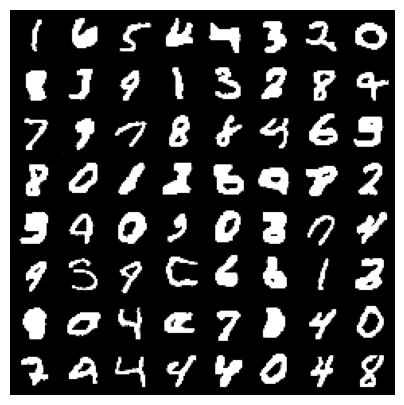

In [ ]:
langevin_samples = langevin_sampler(score_model, diffusion_coef_fn, L=15, T=200)
plot_samples(langevin_samples[-1])

In [ ]:
langevin_ani = generate_denoising_animation(langevin_samples, step_size=10, interval=10)
HTML(langevin_ani.to_html5_video())

### Reverse SDE

In [ ]:
def sde_sampler(score_model, marginal_prob_std, diffusion_coef, batch_size=64, num_steps=1000, device='cuda', eps=1e-3):
  """Generate samples with the Euler-Maruyama discrete SDE solver."""
  t = torch.ones(batch_size, device=device)
  init_x = torch.randn(batch_size, 1, 28, 28, device=device) * marginal_prob_std(t)[:,None,None,None]
  time_steps = torch.linspace(1., eps, num_steps, device=device)
  step_size = time_steps[0] - time_steps[1]
  x = init_x
  x_list = torch.empty((num_steps+1,*x.shape)) # we keep track of evolution for plotting
  i = 0
  with torch.no_grad():
    for time_step in notebook.tqdm(time_steps):
      x_list[i] = x
      i += 1
      batch_time_step = torch.ones(batch_size, device=device) * time_step
      g = diffusion_coef(batch_time_step)
      mean_x = x + (g**2)[:,None,None,None] * score_model(x,batch_time_step) * step_size
      x = mean_x + torch.sqrt(step_size) * g[:,None,None,None] * torch.randn_like(x)
  x_list[-1] = mean_x
  return x_list

  0%|          | 0/1000 [00:00<?, ?it/s]

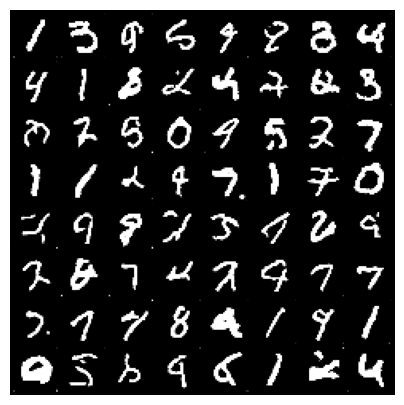

In [ ]:
sde_samples = sde_sampler(score_model, marginal_prob_std_fn, diffusion_coef_fn)
plot_samples(sde_samples[-1])

In [ ]:
sde_ani = generate_denoising_animation(sde_samples, step_size=5, interval=10)
HTML(sde_ani.to_html5_video())

### ODE

In [ ]:
def ode_sampler(score_model, marginal_prob_std, diffusion_coeff, batch_size=64, num_steps=100, device='cuda', eps=1e-3):
  """Generate samples from score-based models with black-box ODE solvers."""
  t = torch.ones(batch_size, device=device)
  # Create the latent code
  init_x = torch.randn(batch_size, 1, 28, 28, device=device) * marginal_prob_std(t)[:, None, None, None]
  shape = init_x.shape

  def score_eval_wrapper(sample, time_steps):
    """A wrapper of the score-based model for use by the ODE solver."""
    sample = torch.tensor(sample, device=device, dtype=torch.float32).reshape(shape)
    time_steps = torch.tensor(time_steps, device=device, dtype=torch.float32).reshape((sample.shape[0], ))
    with torch.no_grad():
      score = score_model(sample, time_steps)
    return score.cpu().numpy().reshape((-1,)).astype(np.float64)

  def ode_func(t, x):
    """The ODE function for use by the ODE solver."""
    time_steps = np.ones((shape[0],)) * t
    g = diffusion_coeff(torch.tensor(t)).cpu().numpy()
    return  -0.5 * (g**2) * score_eval_wrapper(x, time_steps)

  # Run the black-box ODE solver.
  t_eval = np.linspace(1., eps, num_steps+1)
  res = integrate.solve_ivp(ode_func, (1., eps), init_x.reshape(-1).cpu().numpy(), t_eval=t_eval, rtol=1e-5, atol=1e-5, method='RK45')
  x = torch.tensor(res.y, device=device).reshape((batch_size,1,28,28,num_steps+1)).permute(4,0,1,2,3)
  return x

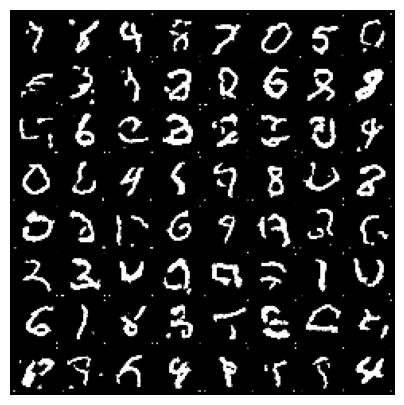

In [ ]:
ode_samples = ode_sampler(score_model, marginal_prob_std_fn, diffusion_coef_fn)
plot_samples(ode_samples[-1])

In [ ]:
ani_ode = generate_denoising_animation(ode_samples, interval=10)
HTML(ani_ode.to_html5_video())

### Predictor-Corrector sampling

In [ ]:
def pc_sampler(score_model,
               marginal_prob_std,
               diffusion_coeff,
               batch_size=64,
               num_steps=1000,
               snr=0.2,
               device='cuda',
               eps=1e-3):
    t = torch.ones(batch_size, device=device)
    init_x = torch.randn(batch_size, 1, 28, 28, device=device) * marginal_prob_std(t)[:, None, None, None]
    time_steps = np.linspace(1., eps, num_steps)
    step_size = time_steps[0] - time_steps[1]
    x = init_x
    x_list = torch.empty((num_steps+1,*x.shape)) # we keep track of evolution for plotting
    i = 0
    with torch.no_grad():
      for time_step in notebook.tqdm(time_steps):
        x_list[i] = x
        i += 1
        batch_time_step = torch.ones(batch_size, device=device) * time_step
        # Corrector step (Langevin MCMC)
        grad = score_model(x, batch_time_step)
        grad_norm = torch.norm(grad.reshape(grad.shape[0], -1), dim=-1).mean()
        noise_norm = np.sqrt(np.prod(x.shape[1:]))
        langevin_step_size = 2 * (snr * noise_norm / grad_norm)**2
        x = x + langevin_step_size * grad + torch.sqrt(2 * langevin_step_size) * torch.randn_like(x)
        # Predictor step (Euler-Maruyama)
        g = diffusion_coeff(batch_time_step)
        x_mean = x + (g**2)[:, None, None, None] * score_model(x, batch_time_step) * step_size
        x = x_mean + torch.sqrt(g**2 * step_size)[:, None, None, None] * torch.randn_like(x)
      # The last step does not include any noise
      x_list[-1] = x_mean
      return x_list

  0%|          | 0/1000 [00:00<?, ?it/s]

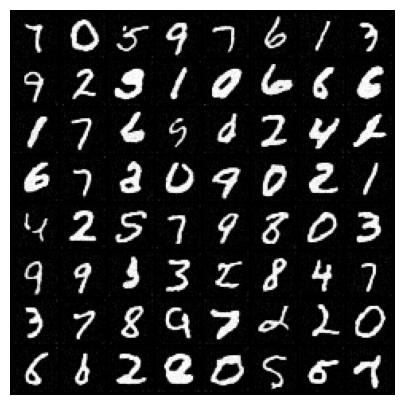

In [ ]:
pc_samples = pc_sampler(score_model, marginal_prob_std_fn, diffusion_coef_fn, num_steps=1000, eps=5e-4)
plot_samples(pc_samples[-1])

In [ ]:
ani_pc = generate_denoising_animation(pc_samples, step_size=5, interval=10)
HTML(ani_pc.to_html5_video())

 ## Class-conditional sampling

### Time-conditional MLP classifier

In [ ]:
class TimeConditionalMLP(nn.Module):
  """Time-conditional MLP to classify noisy images i.e. compute p(y|x_t,t) for all labels y."""
  def __init__(self,embed_dim=128):
    super().__init__()
    self.flatten = nn.Flatten()
    self.embed = nn.Sequential(TimeEmbedding(embed_dim=embed_dim), nn.Linear(embed_dim, embed_dim))
    self.dense1 = nn.Linear(embed_dim, 128)
    self.fc1 = nn.Linear(28*28, 128)
    self.fc2 = nn.Linear(128, 10)
    self.act = nn.ReLU()

  def forward(self, x, t):
    embedding = self.act(self.embed(t))
    x = self.flatten(x)
    x = self.act(self.fc1(x)+self.dense1(embedding))
    x = self.fc2(x)
    return x

def loss_fn(model, x, y, marginal_prob_std, eps=1e-5):
  """Loss function for classifier network.
  Epsilon is used to avoid numerical instability as t goes to 0.
  """
  random_t = torch.rand(x.shape[0], device=x.device) * (1.0 - eps) + eps
  z = torch.randn_like(x)
  std = marginal_prob_std(random_t)
  perturbed_x = x + z * std[:, None, None, None]
  logits = model(perturbed_x, random_t)
  cross_entropy = nn.functional.cross_entropy(logits, y, reduction='none')
  loss = cross_entropy.mean()
  return loss

# define model
clf = nn.DataParallel(TimeConditionalMLP()).to(device) # enables parallelization

# hyperparameters
batch_size = 64
n_epochs = 10
lr = 1e-3
tqdm_epoch = notebook.trange(n_epochs)


# load and prepare data
transform = transforms.Compose([transforms.ToTensor(),transforms.Normalize((0.1307,), (0.3081,))])
trainset = MNIST(root='./data', train=True, download=True, transform=transform)
trainloader = DataLoader(trainset, batch_size=batch_size, shuffle=True)
testset = MNIST(root='./data', train=False, download=True, transform=transform)
testloader = DataLoader(testset, batch_size=batch_size, shuffle=False)

# optimizer
optimizer = Adam(clf.parameters(), lr=lr)

# classic torch training loop
clf.train()
for epoch in tqdm_epoch:
  running_loss = 0.0
  for i, (inputs, labels) in enumerate(trainloader):
    inputs, labels = inputs.to(device), labels.to(device)
    loss = loss_fn(clf, inputs, labels, marginal_prob_std_fn)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    running_loss += loss.item()
  tqdm_epoch.set_description(f'Average loss: {running_loss/len(trainloader):.3f}')

  0%|          | 0/10 [00:00<?, ?it/s]

### Conditional score $\nabla_\mathbf{x} \log p(y|\mathbf{x}_t)$

In [ ]:
def cond_score(clf, x, y, t, eps=1e-6):
  """Compute the score of the classifier i.e. ∇_x[log p(y|x)]."""
  num_classes = 10 # MNIST
  x.requires_grad_(True)
  logits = clf(x,t)
  p_y_given_x = nn.functional.softmax(logits, dim=-1)[:,y]
  p_y_given_x_log = torch.log(p_y_given_x + eps)
  x.retain_grad()
  p_y_given_x_log.backward(torch.ones_like(p_y_given_x_log))
  gradient = x.grad
  return gradient

### Conditional SDE sampler

In [ ]:
def cond_sde_sampler(y, score_model, cond_score, marginal_prob_std, diffusion_coef, batch_size=64, num_steps=1000, device='cuda', eps=1e-3):
  """Generate conditional samples from score-based models with the Euler-Maruyama discrete SDE solver."""
  t = torch.ones(batch_size, device=device)
  init_x = torch.randn(batch_size, 1, 28, 28, device=device) * marginal_prob_std(t)[:,None,None,None]
  time_steps = torch.linspace(1., eps, num_steps, device=device)
  step_size = time_steps[0] - time_steps[1]
  y = torch.ones(batch_size, device=device) * y
  y = y.type(torch.int64)
  x = init_x
  x_list = torch.empty((num_steps+1,*x.shape)) # we keep track of evolution for plotting
  i = 0
  for time_step in notebook.tqdm(time_steps):
    x_list[i] = x
    i += 1
    batch_time_step = torch.ones(batch_size, device=device) * time_step
    g = diffusion_coef(batch_time_step)
    with torch.no_grad():
      uncond = score_model(x, batch_time_step)
    cond = cond_score(clf, x, y, batch_time_step)
    score = uncond + cond
    mean_x = x + (g**2)[:,None,None,None] * score * step_size
    x = mean_x + torch.sqrt(step_size) * g[:,None,None,None] * torch.randn_like(x)
  x_list[-1] = mean_x
  return x_list

  0%|          | 0/1000 [00:00<?, ?it/s]

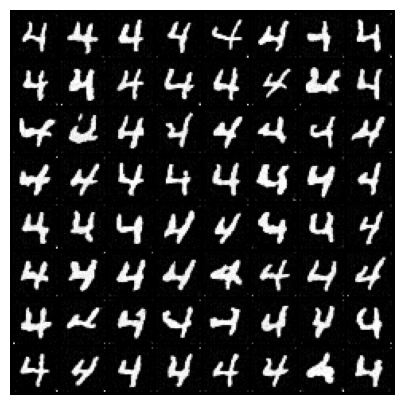

In [ ]:
cond_sde_samples = cond_sde_sampler(4, score_model, cond_score, marginal_prob_std_fn, diffusion_coef_fn, eps=5e-4)
plot_samples(cond_sde_samples[-1])

In [ ]:
cond_sde_ani = generate_denoising_animation(cond_sde_samples, step_size=5, interval=10)
HTML(cond_sde_ani.to_html5_video())

## Inpainting

In [ ]:
def sde_inpainter(x, mask, score_model, marginal_prob_std, diffusion_coef, num_steps=1000, eps=1e-3):
  """Takes as input a batch of images x, a batch of masks mask, and outputs a batch of inpainted images."""
  batch_size = x.shape[0]
  t = torch.ones(batch_size, device=x.device)
  time_steps = torch.linspace(1., eps, num_steps)
  step_size = time_steps[0] - time_steps[1]
  x_list = torch.empty((num_steps+1,*x.shape)) # we keep track of evolution for plotting
  std = marginal_prob_std(t)[:,None,None,None]
  init_x = x * mask #+ z_T * (1-mask)
  x = init_x
  i = 0
  with torch.no_grad():
    for time_step in notebook.tqdm(time_steps):
      x_list[i] = x
      i += 1
      batch_time_step = torch.ones(batch_size, device=x.device) * time_step
      g = diffusion_coef(batch_time_step)
      std = marginal_prob_std(batch_time_step)[:,None,None,None]
      z = x + torch.randn_like(x)*std # sample from p(x_t|x_0)
      u = x * mask + z * (1-mask)
      mean_x = x + (g**2)[:,None,None,None] * score_model(u,batch_time_step) * step_size * (1-mask)
      x = mean_x + torch.sqrt(step_size) * g[:,None,None,None] * torch.randn_like(x) * (1-mask)
  x_list[-1] = mean_x
  return x_list

  0%|          | 0/1000 [00:00<?, ?it/s]

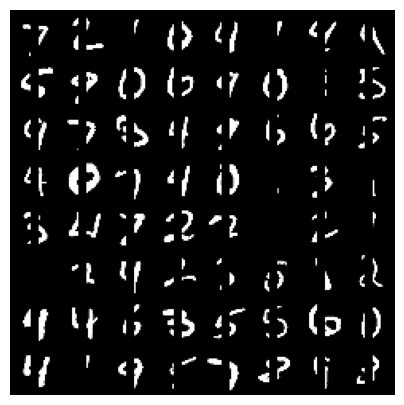

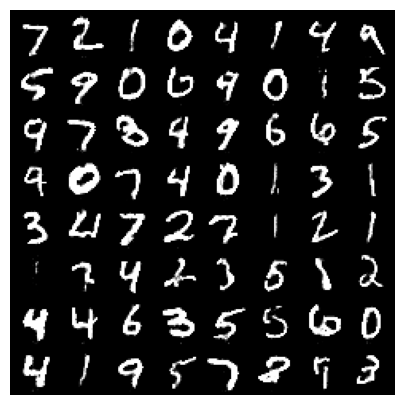

In [ ]:
# take the first batch as input images to inpaint
x, y = next(iter(testloader))
x, y = x.to(device), y.to(device)
# define a mask (here a vertical stripe in the middle)
mask = torch.ones_like(x)
mask[:,:,:,11:16] = 0
mask = mask.to(device)

# generate samples
sde_inpainter_samples = sde_inpainter(x, mask, score_model, marginal_prob_std_fn, diffusion_coef_fn, eps=5e-4)
plot_samples(sde_inpainter_samples[0])
plot_samples(sde_inpainter_samples[-1])

In [ ]:
sde_inpainter_ani = generate_denoising_animation(sde_inpainter_samples, step_size=5, interval=10)
HTML(sde_inpainter_ani.to_html5_video())